# Price Analysis

This analysis looks at the price-per-night values in the dataset and applies data cleaning and EDA methods to answer the following questions: 

- What is the price distribution in each city?
- What is the average/max/min price in each city?
- How do the cities compare?
- What are the price trends over the last four quarters?

To answer these questions the following steps are taken:

- Fixing discrepancy in currencies with an API
- Visualizing price column with box plot to see the distribution/outliers
- Calculating the outliers with IQR
- Creating histograms for overall price trends for each city (no outliers) 
- Calculating stats for each city - min/max/mean
- Creating a bar chart to compare stats for all cities
- Calculating average price per each quarter for each city 
- Combining average values in a line graph to compare the price trends over quarter for all cities

In [1]:
#importing all the functions from the functions_price.py file
from functions_price import *

#### Step 1: Importing the data

In [2]:
#Calling the function for Rome
file_list = ['data/rome_listing_Q1_24.csv', 'data/rome_listing_Q4_23.csv', 'data/rome_listing_Q3_23.csv', 'data/rome_listing_Q2_23.csv']
merged_data_rome = merge_csv_files(file_list)
#Call the function for Madrid
file_list = ['data/madrid_listing_Q1_24.csv', 'data/madrid_listing_Q4_23.csv', 'data/madrid_listing_Q3_23.csv', 'data/madrid_listing_Q2_23.csv']
merged_data_madrid = merge_csv_files(file_list)
#Calling the function for Barcelona
file_list = ['data/barcelona_listing_Q1_24.csv', 'data/barcelona_listing_Q4_23.csv', 'data/barcelona_listing_Q3_23.csv', 'data/barcelona_listing_Q2_23.csv']
merged_data_barcelona = merge_csv_files(file_list)
#Calling the function for Istanbul
file_list = ['data/istanbul_listing_Q1_24.csv', 'data/istanbul_listing_Q4_23.csv', 'data/istanbul_listing_Q3_23.csv', 'data/istanbul_listing_Q2_23.csv']
merged_data_istanbul = merge_csv_files(file_list)
#Calling the function for London
file_list = ['data/london_listing_Q1_24.csv', 'data/london_listing_Q4_23.csv', 'data/london_listing_Q3_23.csv', 'data/london_listing_Q2_23.csv']
merged_data_london = merge_csv_files(file_list)
#Calling the function for Paris
file_list = ['data/paris_listing_Q1_24.csv', 'data/paris_listing_Q4_23.csv', 'data/paris_listing_Q3_23.csv', 'data/paris_listing_Q2_23.csv']
merged_data_paris = merge_csv_files(file_list)



/Users/lasmaoficierecakste/Documents/GitHub/Project_3/functions_price.py:16: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file)


In [3]:
#defining the list of dataframes
df_list = [merged_data_rome, merged_data_madrid, merged_data_barcelona, merged_data_istanbul, merged_data_london, merged_data_paris]
final_dataframe = merge_data_frames_currency(df_list)

#### Step 2: Converting Currency to EUR

As there are dicrepancies in the currencies due to the data representing different locations it is necessary to convert all currencies to a unified one - in this case EUR - to be able to perform further analysis. The exchange is performed with a free currency exchange API to convert the TRY and GBP values to EUR using live rates.

In [4]:
try:
    # Fetch exchange rates
    exchange_rates = get_exchange_rates()

    # Convert prices to EUR
    final_dataframe['price_in_eur'] = final_dataframe.apply(lambda row: row['price'] / exchange_rates[row['currency']], axis=1)

    dataframe_currency = final_dataframe.copy()

except Exception as e:
    print("Error:", e)

As the original dataframe had currency and price columns, after conversion they are replaced with a single column - price_in_eur. 

In [5]:
# Drop the price and currency columns
dataframe_currency = dataframe_currency.drop(['price', 'currency'], axis=1)

In [6]:
# Move the new column to the middle of the data frame
col = dataframe_currency.pop('price_in_eur')
dataframe_currency.insert(9, 'price_in_eur', col)

Checking the statistics for the price_in_eur column and removing the values that are equal to 0.00

In [7]:
#Checking the minimum price
dataframe_currency['price_in_eur'].describe()

count    1.092248e+06
mean     1.865730e+02
std      6.160281e+02
min      0.000000e+00
25%      6.500000e+01
50%      1.185396e+02
75%      2.136910e+02
max      9.495021e+04
Name: price_in_eur, dtype: float64

In [8]:
# Drop rows with price_in_eur = 0
dataframe_currency = dataframe_currency[dataframe_currency['price_in_eur'] != 0]

#### Step 3: Analysing price distribution

To first understand the general dustribution of prices in each location a box plot is generated to get an overview of the price range and determine if there are possible outliers in the data for each city.

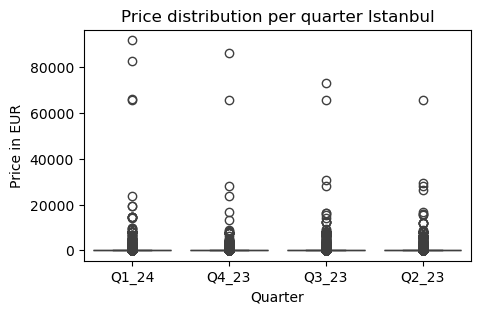

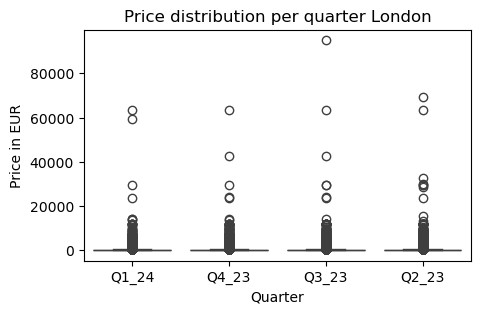

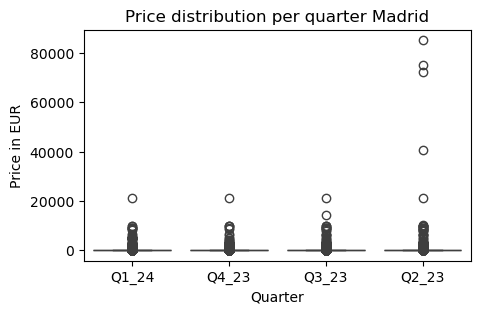

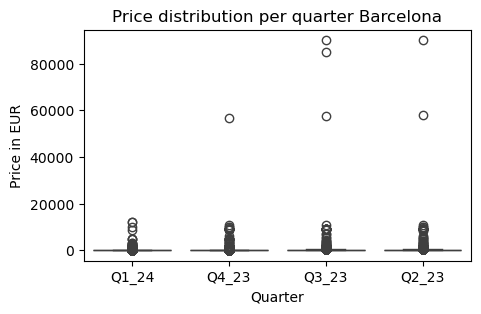

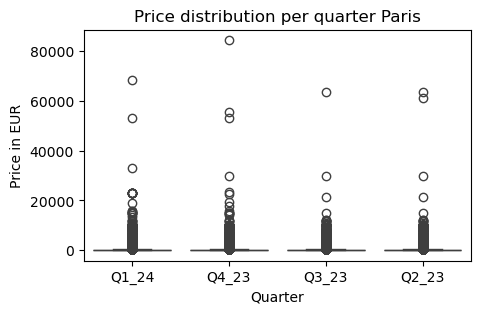

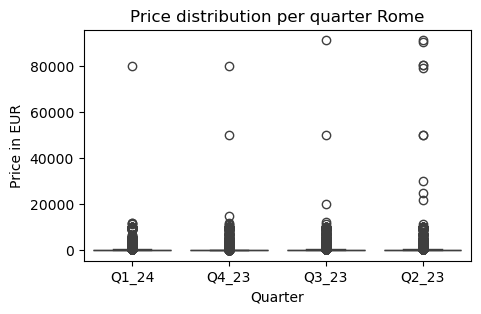

In [9]:
# List of cities
cities = ['Istanbul', 'London', 'Madrid', 'Barcelona', 'Paris', 'Rome']

# Process and visualize the data
city_dataframes = visualize_price_distribution_with_outliers(dataframe_currency, cities)

- As the price range is very large and multiple values seem to fall far above the general tendency, they are removed to go on with further analysis of general price trends. In order to do this lower and upper bound are calculated using IQR method - IQR = Q3 - Q1 and the values outside of these bounds are removed. 
- New price distribution with removed outliers is visualised using a histogram.

In [9]:
# List of cities
cities = ['Istanbul', 'London', 'Madrid', 'Barcelona', 'Paris', 'Rome']

# Process and visualize the data
city_dataframes = visualize_price_distribution_without_outliers(dataframe_currency, cities)

### Step 4: Comparing the min/max and average price 

Firstly applying a function to ciolculate the min/max and mean price for each city and creating a new data frame with these values.

In [10]:
calculate_stats(dataframe_currency)

,city,min_price,max_price,mean_price
0,Rome,8.00,339.00,133.14
1,Madrid,8.00,255.00,97.59
2,Barcelona,8.00,330.00,114.73
3,Istanbul,5.05,142.19,48.11
4,London,8.30,414.89,153.80
5,Paris,8.00,540.00,169.66


The price comparison between cities is visualised using bar chart that combines all the six cities and shows the min/max and mean price of each. 

In [11]:
# Calculate stats for each city
prices_df = calculate_stats(dataframe_currency)

# Create a grouped bar chart using Plotly Graph Objects
fig = go.Figure()

# Add bars for min, max, and mean prices
fig.add_trace(go.Bar(
    x=prices_df['city'],
    y=prices_df['min_price'],
    name='Min Price',
    marker_color='blue',
    text=prices_df['min_price'],
    textposition='outside'
))

fig.add_trace(go.Bar(
    x=prices_df['city'],
    y=prices_df['max_price'],
    name='Max Price',
    marker_color='orange',
    text=prices_df['max_price'],
    textposition='outside'
))

fig.add_trace(go.Bar(
    x=prices_df['city'],
    y=prices_df['mean_price'],
    name='Mean Price',
    marker_color='green',
    text=prices_df['mean_price'],
    textposition='outside'
))

# Update layout
fig.update_layout(
    title='Airbnb Prices per Night (Excluding Outliers)',
    xaxis_title='City',
    yaxis_title='Price (EUR)',
    barmode='group',  # Group bars
    width=1200,  # Adjust the width as needed
    height=600 
)

# Show the plot
fig.show()

#### Step 5: Analysig the price trends over time

First a function is used to calculate the average price per quarter for each city and this data is saved in a new data frame.

In [12]:
quarters_to_compare = ['Q1_24', 'Q4_23', 'Q3_23', 'Q2_23']

# Calculate average prices for the specified quarters
avg_price_comparison = calculate_average_prices(dataframe_currency, quarters_to_compare)
avg_price_comparison

,city,price_in_eur_Q1_24,price_in_eur_Q4_23,price_in_eur_Q3_23,price_in_eur_Q2_23
0,Barcelona,146.488264,126.494083,162.802389,177.700273
1,Istanbul,92.893520,81.597347,75.849462,74.130587
2,London,213.693332,215.910115,214.978339,222.335738
3,Madrid,137.574294,129.016058,129.157000,149.114706
4,Paris,288.665830,221.161739,205.105914,198.103275
5,Rome,186.792302,172.378912,207.733312,230.872310


To visualise the price changes over time in all locations, the data is put in a line graph.

In [26]:
# Melt the DataFrame to long format
df_melted = avg_price_comparison.melt(id_vars='city', var_name='quarter', value_name='price')

# Convert quarter names to a proper order
df_melted['quarter'] = df_melted['quarter'].str.replace('price_in_eur_', '')
df_melted['quarter'] = pd.Categorical(df_melted['quarter'], 
                                      categories=['Q2_23', 'Q3_23', 'Q4_23', 'Q1_24'], 
                                      ordered=True)

# Create a line plot
fig = px.line(df_melted, x='quarter', y='price', color='city', markers=True, title='Price Trends Over Quarters')
fig.update_layout(
    xaxis_title='Quarter',
    yaxis_title='Price in EUR',
    title_font_size=16,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14
)
fig.show()